In [33]:
import os
import shutil
import random
import torch
import cv2
import json
import pytesseract
import easyocr
import matplotlib.pyplot as plt
from ultralytics import YOLO
from paddleocr import PaddleOCR
# Display matplotlib plots in the notebook
%matplotlib inline  

In [4]:

# Define the directories
output_img_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/images"
output_label_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/labels"

# Create the directories (exist_ok=True to avoid errors if the directiores already exist)
os.makedirs(output_img_dir, exist_ok=True)
os.makedirs(output_label_dir, exist_ok=True)

print("Directories created successfully!")


Directories created successfully!


In [7]:
# convert the CCPD dataset to YOLO format(labels)

# CCPD dataset directory
dataset_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD2019/ccpd_base"
output_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/labels"

os.makedirs(output_dir, exist_ok=True)

# Loop through images
for filename in os.listdir(dataset_dir):
    if filename.endswith(".jpg"):
        # Extract bounding box info from filename
        parts = filename.split("-")
        bbox = parts[2].split("_")  # Extract bounding box coordinates
        x_min, y_min = map(int, bbox[0].split("&"))
        x_max, y_max = map(int, bbox[1].split("&"))

        # Convert to YOLO format (normalized)
        img_w, img_h = 1280, 720  # CCPD images are 720x1280
        x_center = (x_min + x_max) / (2 * img_w)
        y_center = (y_min + y_max) / (2 * img_h)
        width = (x_max - x_min) / img_w
        height = (y_max - y_min) / img_h

        # Create YOLO annotation file
        label_path = os.path.join(output_dir, filename.replace(".jpg", ".txt"))
        with open(label_path, "w") as f:
            f.write(f"0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")

print(" Annotation conversion completed!")


 Annotation conversion completed!


In [19]:
# move all images to the new directory (images)

# Define paths
ccpd_base_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD2019/ccpd_base"
output_images_dir= "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/images"

# Create image output directories if they don't exist
os.makedirs(output_images_dir, exist_ok=True)

# Move all images to the new directory
image_files = [f for f in os.listdir(ccpd_base_dir) if f.endswith(".jpg")]

for img_file in image_files:
    src_path = os.path.join(ccpd_base_dir, img_file)
    dst_path = os.path.join(output_images_dir, img_file)
    shutil.move(src_path, dst_path)

print(f" Successfully moved {len(image_files)} images to {output_images_dir}")



 Successfully moved 199996 images to /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/images


In [20]:
# check for missing images and labels 
# Define paths
images_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/images"
labels_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/labels"

# Get filenames without extensions
image_files = set([f.replace(".jpg", "") for f in os.listdir(images_dir) if f.endswith(".jpg")])
label_files = set([f.replace(".txt", "") for f in os.listdir(labels_dir) if f.endswith(".txt")])

# Check for mismatches
missing_labels = image_files - label_files  # Images without labels
missing_images = label_files - image_files  # Labels without images

# Print results
print(f"Images without labels: {len(missing_labels)}")
print(f"Labels without images: {len(missing_images)}")

if missing_labels:
    print("⚠️ Images without labels:")
    print(missing_labels)

if missing_images:
    print("⚠️ Labels without images:")
    print(missing_images)


Images without labels: 0
Labels without images: 0


In [21]:
# Split the dataset into train, validation, and test sets
# Define paths
base_images_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/images"
base_labels_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/labels"

# Output directories for train/val/test
split_dirs = {
    "train": "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/train",
    "val": "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/val",
    "test": "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test"
}

# Create directories
for split in split_dirs.values():
    os.makedirs(os.path.join(split, "images"), exist_ok=True)
    os.makedirs(os.path.join(split, "labels"), exist_ok=True)

# Get all filenames
all_filenames = [f.replace(".jpg", "") for f in os.listdir(base_images_dir) if f.endswith(".jpg")]

# Shuffle dataset
random.seed(42)  # Ensure reproducibility
random.shuffle(all_filenames)

# Split dataset (80% train, 10% val, 10% test)
train_split = int(len(all_filenames) * 0.8)
val_split = int(len(all_filenames) * 0.9)

train_files = all_filenames[:train_split]
val_files = all_filenames[train_split:val_split]
test_files = all_filenames[val_split:]

# Function to move files
def move_files(file_list, split):
    for file in file_list:
        shutil.move(os.path.join(base_images_dir, file + ".jpg"), os.path.join(split_dirs[split], "images", file + ".jpg"))
        shutil.move(os.path.join(base_labels_dir, file + ".txt"), os.path.join(split_dirs[split], "labels", file + ".txt"))

# Move files to respective directories
move_files(train_files, "train")
move_files(val_files, "val")
move_files(test_files, "test")

print(" Dataset split completed successfully!")
print(f"Train: {len(train_files)} images")
print(f"Validation: {len(val_files)} images")
print(f"Test: {len(test_files)} images")


 Dataset split completed successfully!
Train: 159996 images
Validation: 20000 images
Test: 20000 images


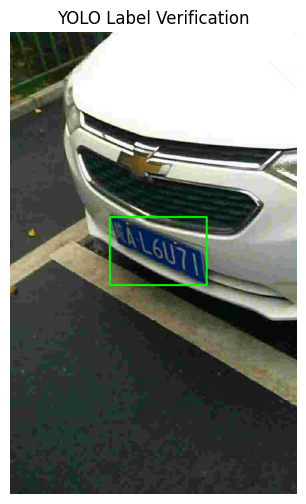

In [22]:
# verify if the annotation is convered correctly by displaying the bounding box on the image
# Define paths
image_dir = "CCPD_YOLO/test/images"  # can change to train or val to view images from the respective directories
label_dir = "CCPD_YOLO/test/labels"

# Get all image files
image_files = [f for f in os.listdir(image_dir) if f.endswith(".jpg")]

# Randomly select an image
random_image = random.choice(image_files)
image_path = os.path.join(image_dir, random_image)
label_path = os.path.join(label_dir, random_image.replace(".jpg", ".txt"))

# Read image
image = cv2.imread(image_path)
h, w, _ = image.shape

# Read label
with open(label_path, "r") as f:
    lines = f.readlines()

for line in lines:
    data = line.strip().split()
    class_id, x_center, y_center, width, height = map(float, data)

    # Convert back to pixel coordinates
    x_min = int((x_center - width / 2) * w)
    y_min = int((y_center - height / 2) * h)
    x_max = int((x_center + width / 2) * w)
    y_max = int((y_center + height / 2) * h)

    # Draw bounding box
    cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 3)

# Display
plt.figure(figsize=(8, 6))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title("YOLO Label Verification")
plt.show()

In [3]:

# Create a small dataset for quick testing (copy 1000 train, 200 val, 200 test images)

# Define full dataset directories
full_train_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/train"
full_val_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/val"
full_test_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test"

# Define small dataset directories for quick testing
small_train_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/small_train"
small_val_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/small_val"
small_test_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/small_test"

# Create directories for small dataset
for path in [small_train_dir, small_val_dir, small_test_dir]:
    os.makedirs(os.path.join(path, "images"), exist_ok=True)
    os.makedirs(os.path.join(path, "labels"), exist_ok=True)

# Function: Randomly sample and copy files
def sample_files(source_dir, target_dir, sample_size):
    image_files = [f for f in os.listdir(os.path.join(source_dir, "images")) if f.endswith(".jpg")]
    sampled_files = random.sample(image_files, sample_size)

    for file in sampled_files:
        shutil.copy(os.path.join(source_dir, "images", file), os.path.join(target_dir, "images", file))
        shutil.copy(os.path.join(source_dir, "labels", file.replace(".jpg", ".txt")), os.path.join(target_dir, "labels", file.replace(".jpg", ".txt")))

# Extract a small dataset for quick testing
sample_files(full_train_dir, small_train_dir, 1000)
sample_files(full_val_dir, small_val_dir, 200)
sample_files(full_test_dir, small_test_dir, 200)

print(" Small dataset created: train (1000), val (200), test (200)")


 Small dataset created: train (1000), val (200), test (200)


In [11]:

# Create a small dataset for quick testing (copy 1000 train, 200 val, 200 test images)

# Define full dataset directories
full_train_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/train"
full_val_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/val"
full_test_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test"

# Define small dataset directories for quick testing
small_train_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/sample_train"
small_val_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/sample_val"
small_test_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/ample_test"

# Create directories for small dataset
for path in [small_train_dir, small_val_dir, small_test_dir]:
    os.makedirs(os.path.join(path, "images"), exist_ok=True)
    os.makedirs(os.path.join(path, "labels"), exist_ok=True)

# Function: Randomly sample and copy files
def sample_files(source_dir, target_dir, sample_size):
    image_files = [f for f in os.listdir(os.path.join(source_dir, "images")) if f.endswith(".jpg")]
    sampled_files = random.sample(image_files, sample_size)

    for file in sampled_files:
        shutil.copy(os.path.join(source_dir, "images", file), os.path.join(target_dir, "images", file))
        shutil.copy(os.path.join(source_dir, "labels", file.replace(".jpg", ".txt")), os.path.join(target_dir, "labels", file.replace(".jpg", ".txt")))

# Extract a small dataset for quick testing
sample_files(full_train_dir, small_train_dir, 50)
sample_files(full_val_dir, small_val_dir, 20)
sample_files(full_test_dir, small_test_dir, 20)

print(" Sample dataset created: train (50), val (20), test (20)")


 Sample dataset created: train (50), val (20), test (20)


In [69]:
pip install ultralytics


Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple
Note: you may need to restart the kernel to use updated packages.


In [11]:
# Create a YAML file for YOLOv8

yaml_content = """path: "CCPD_YOLO"
train: train/images
val: val/images
test: test/images

nc: 1
names: ["license_plate"]
"""

yaml_path = "CCPD_YOLO/yolo_config.yaml"

# Write YAML content to file
with open(yaml_path, "w") as f:
    f.write(yaml_content)

print("YAML file created successfully!")


YAML file created successfully!


In [46]:
# Create a YOLO configuration file



# Load YOLOv8 pre-trained model
model = YOLO("yolov8m.pt")  # yolov8m got more parameters than yolov8n (smallest model)

# Train YOLO on the small dataset
model.train(
    data="CCPD_YOLO/yolo_config.yaml",  # Configuration file(
    epochs=50,  
    batch=64,   # Batch size per iteration
    imgsz=640,   # Image size
    device="cuda",
    project="runs/detect",  # Save to project folder
    name="train_correct_labels", # Name of the run
    lr0=0.015,  # Initial learning rate
    lrf=0.2,  
    patience=3,  # Stop training if validation loss does not improve for 3 epochs
    
)

print(" YOLO  training completed!")



New https://pypi.org/project/ultralytics/8.3.78 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.76 🚀 Python-3.11.8 torch-2.2.2+cu121 CUDA:0 (NVIDIA GeForce RTX 4090, 24111MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=CCPD_YOLO/yolo_config.yaml, epochs=50, time=None, patience=3, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=runs/detect, name=train_correct_labels, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, em

train: Scanning /home/featurize/CCPD_YOLO/train/labels... 159996 images, 0 backgrounds, 0 corrupt: 100%|██████████| 159996/159996 [03:31<00:00, 757.26it/s]


train: New cache created: /home/featurize/CCPD_YOLO/train/labels.cache


val: Scanning /home/featurize/CCPD_YOLO/val/labels... 20000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20000/20000 [00:20<00:00, 967.47it/s] 


val: New cache created: /home/featurize/CCPD_YOLO/val/labels.cache
Plotting labels to runs/detect/train_correct_labels/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.015' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train_correct_labels
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      22.2G     0.9877     0.4754      1.037        114        640: 100%|██████████| 2500/2500 [17:00<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:48<00:00,  3.21it/s]

                   all      20000      20000      0.999          1      0.995      0.763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      22.4G     0.9818      0.405      1.056        112        640: 100%|██████████| 2500/2500 [16:48<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:48<00:00,  3.21it/s]

                   all      20000      20000      0.999          1      0.995      0.773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      22.4G     0.9904     0.4099      1.072        102        640: 100%|██████████| 2500/2500 [16:49<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:49<00:00,  3.19it/s]

                   all      20000      20000          1          1      0.995      0.774



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      22.4G     0.9756     0.3949      1.064        120        640: 100%|██████████| 2500/2500 [17:02<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:49<00:00,  3.20it/s]

                   all      20000      20000          1          1      0.995      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      22.3G     0.9604      0.376      1.063        102        640: 100%|██████████| 2500/2500 [17:01<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:49<00:00,  3.20it/s]

                   all      20000      20000          1          1      0.995      0.785



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      22.4G     0.9493     0.3645      1.073        103        640: 100%|██████████| 2500/2500 [17:01<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:49<00:00,  3.18it/s]

                   all      20000      20000          1          1      0.995      0.785



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      22.4G     0.9455     0.3607      1.096        100        640: 100%|██████████| 2500/2500 [16:59<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:49<00:00,  3.17it/s]

                   all      20000      20000          1          1      0.995      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      22.4G     0.9421     0.3568      1.071        112        640: 100%|██████████| 2500/2500 [17:01<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:47<00:00,  3.28it/s]

                   all      20000      20000          1          1      0.995      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      22.4G     0.9412     0.3538      1.074         99        640: 100%|██████████| 2500/2500 [16:57<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:49<00:00,  3.19it/s]

                   all      20000      20000          1          1      0.995      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      22.1G     0.9383     0.3508      1.061        117        640: 100%|██████████| 2500/2500 [17:00<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:46<00:00,  3.35it/s]

                   all      20000      20000          1          1      0.995      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      22.4G     0.9365     0.3487      1.055        117        640: 100%|██████████| 2500/2500 [16:49<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:48<00:00,  3.22it/s]

                   all      20000      20000          1          1      0.995      0.786
EarlyStopping: Training stopped early as no improvement observed in last 3 epochs. Best results observed at epoch 8, best model saved as best.pt.
To update EarlyStopping(patience=3) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



11 epochs completed in 3.266 hours.
Optimizer stripped from runs/detect/train_correct_labels/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train_correct_labels/weights/best.pt, 52.0MB

Validating runs/detect/train_correct_labels/weights/best.pt...
Ultralytics 8.3.76 🚀 Python-3.11.8 torch-2.2.2+cu121 CUDA:0 (NVIDIA GeForce RTX 4090, 24111MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:54<00:00,  2.90it/s]


                   all      20000      20000          1          1      0.995      0.787
Speed: 0.0ms preprocess, 1.0ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detect/train_correct_labels
 YOLO  training completed!


In [63]:
# Evaluate the model on the validation set

metrics = model.val(data="CCPD_YOLO/yolo_config.yaml", split="val")

print("mAP@0.5:", metrics.box.map50)       
print("mAP@0.5:0.95:", metrics.box.map)    

Ultralytics 8.3.76 🚀 Python-3.11.8 torch-2.2.2+cu121 CUDA:0 (NVIDIA GeForce RTX 4090, 24111MiB)


val: Scanning /home/featurize/CCPD_YOLO/val/labels.cache... 20000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20000/20000 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1250/1250 [01:06<00:00, 18.69it/s]


                   all      20000      20000          1          1      0.995      0.787
Speed: 0.1ms preprocess, 1.7ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/val4
mAP@0.5: 0.9949889988998901
mAP@0.5:0.95: 0.7873588841484043


In [ ]:
#fine tune (if needed)



# Load the pre-trained YOLO model with previous weights
model = YOLO("runs/detect/train_correct_labels/weights/best.pt")  

# Train the model with optimized settings
model.train(
    data="CCPD_YOLO/yolo_config.yaml",  
    epochs=25,  
    batch=64,  
    imgsz=640,  
    device="cuda",  
    
    # Early stopping and learning rate control
    patience=3,  # Stop training if no improvement in validation for 3 consecutive epochs
    cos_lr=True,  # Use Cosine Learning Rate Decay for smooth learning rate adjustment
    lrf=0.3,  # Learning rate final scaling factor to prevent excessive decay

    # Regularization and dropout
    dropout=0.1,  # Dropout to prevent overfitting

    # Data Augmentation (YOLOv8 built-in with additional settings)
    augment=True,  # Enable built-in augmentation techniques
    degrees=5,  # Randomly rotate images by up to ±5 degrees
    scale=0.5,  # Random scaling between 50% and 150% of original size
    shear=2,  # Apply slight shearing transformation (2 degrees max)
    perspective=0.0005,  # Introduce small perspective distortions
    flipud=0.0,  # 0% chance of flipping image upside down
    fliplr=0.0  # 0% chance of flipping image horizontally
)

print("Training started with fine-tuned augmentation and early stopping.")

In [12]:
pip install opencv-python

Note: you may need to restart the kernel to use updated packages.



image 1/1 /home/featurize/CCPD_YOLO/test/images/0141056034483-89_90-240&412_437&501-439&482_249&490_246&416_436&408-0_0_23_24_25_32_29-84-23.jpg: 640x416 1 license_plate, 7.1ms
Speed: 1.4ms preprocess, 7.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)


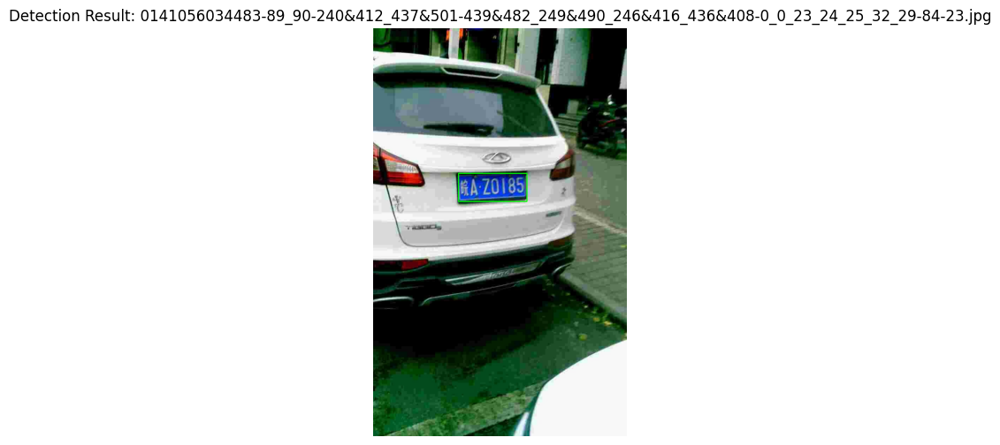


image 1/1 /home/featurize/CCPD_YOLO/test/images/0258620689655-90_87-205&540_489&646-489&638_213&640_211&545_487&543-0_0_9_27_11_26_32-105-177.jpg: 640x416 1 license_plate, 7.7ms
Speed: 1.5ms preprocess, 7.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)


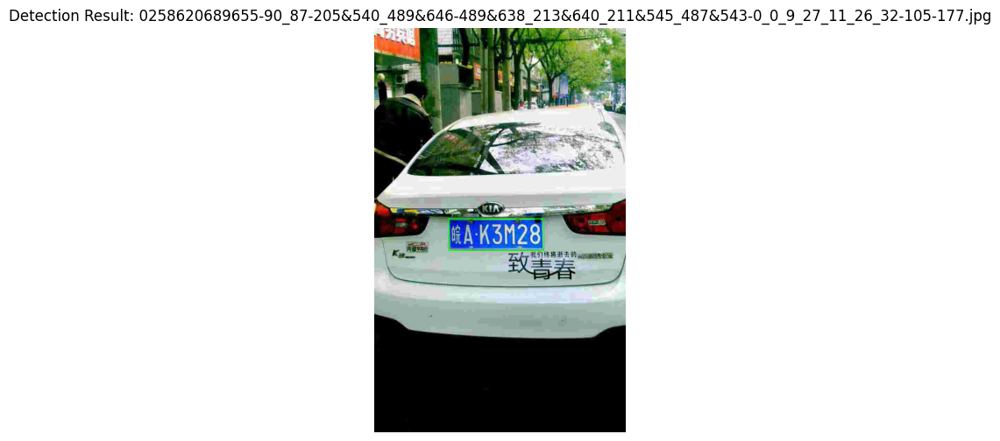


image 1/1 /home/featurize/CCPD_YOLO/test/images/0304837164751-95_79-110&519_387&647-398&643_116&605_103&512_385&550-0_0_7_30_26_27_19-131-69.jpg: 640x416 1 license_plate, 7.7ms
Speed: 1.5ms preprocess, 7.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)


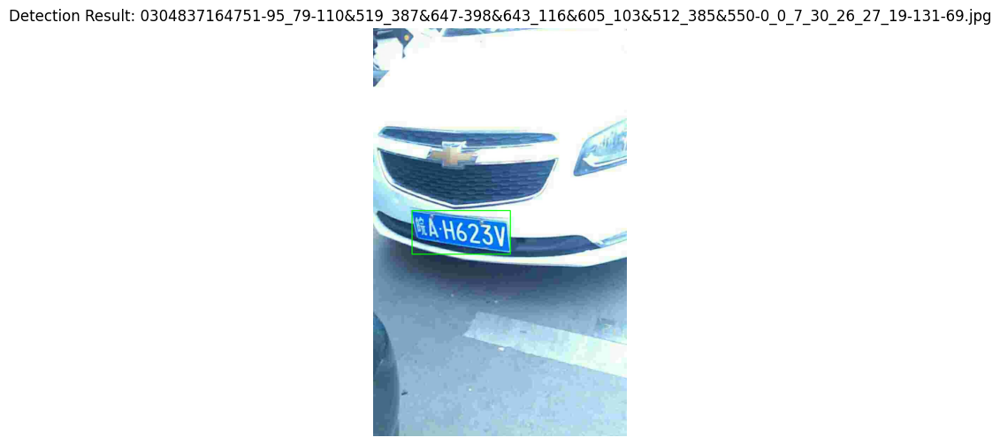


image 1/1 /home/featurize/CCPD_YOLO/test/images/0180926724138-92_79-221&519_441&618-445&617_225&592_205&510_425&535-0_12_21_25_26_25_33-119-96.jpg: 640x416 1 license_plate, 7.6ms
Speed: 1.5ms preprocess, 7.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)


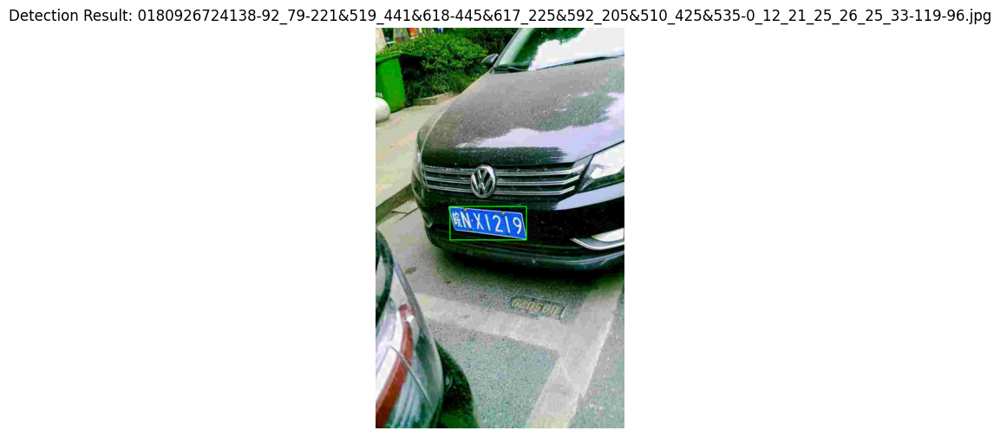


image 1/1 /home/featurize/CCPD_YOLO/test/images/0151915708812-90_89-223&526_457&589-449&607_223&602_227&522_453&527-0_0_25_3_25_24_27-86-25.jpg: 640x416 1 license_plate, 7.6ms
Speed: 1.5ms preprocess, 7.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)


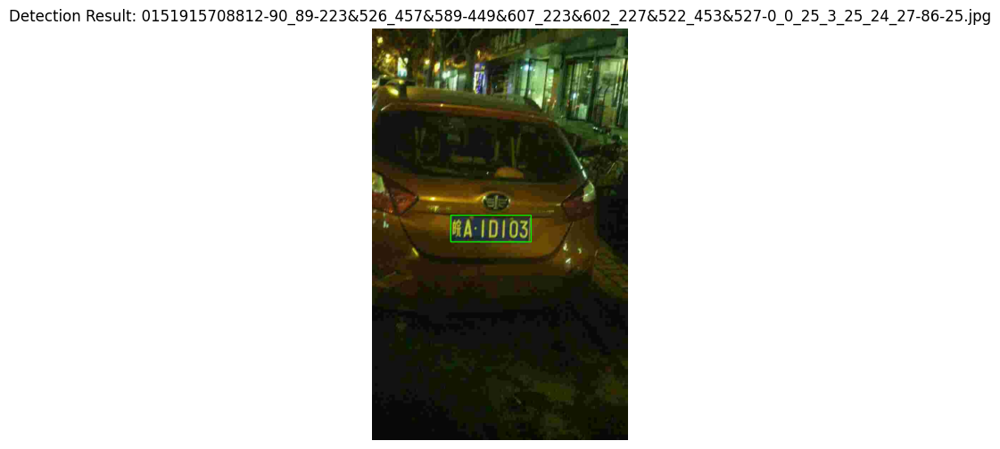

YOLO license plate detection test completed successfully!


In [73]:
#verify the trained model by testing it on the test dataset(manually check the bounding box on the image)

# Load the trained YOLO model (ensure the correct weight path)
model = YOLO("runs/detect/train_correct_labels/weights/best.pt")  # Modify to your actual path

# Define the test image directory
test_image_dir = "CCPD_YOLO/test/images"

# Select a few test images
test_images = os.listdir(test_image_dir)[:5]  # Select the first 5 images

for img_name in test_images:
    img_path = os.path.join(test_image_dir, img_name)
    
    # Perform YOLO detection
    results = model(img_path)

    # Read the image
    img = cv2.imread(img_path)
    
    # Draw bounding boxes on the image
    for r in results:
        for box in r.boxes.xyxy:  # x_min, y_min, x_max, y_max
            x_min, y_min, x_max, y_max = map(int, box)
            cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)  # Green bounding box

    # Display the image
    plt.figure(figsize=(8, 6))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(f"Detection Result: {img_name}")
    plt.show()

print("YOLO license plate detection test completed successfully!")


In [48]:
# Print the results
print(results)

# print the bounding box coordinates, confidence scores, and class labels
print("Bounding boxes (xyxy):", results[0].boxes.xyxy)
print("Confidence scores:", results[0].boxes.conf)
print("Class labels:", results[0].boxes.cls)


image 1/1 /home/featurize/CCPD_YOLO/test/images/0151915708812-90_89-223&526_457&589-449&607_223&602_227&522_453&527-0_0_25_3_25_24_27-86-25.jpg: 640x416 1 license_plate, 17.3ms
Speed: 6.3ms preprocess, 17.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 416)
[ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'license_plate'}
obb: None
orig_img: array([[[ 9, 48, 63],
        [ 9, 48, 63],
        [ 9, 48, 63],
        ...,
        [29, 60, 33],
        [29, 60, 33],
        [29, 60, 33]],

       [[ 9, 48, 63],
        [ 9, 48, 63],
        [ 9, 48, 63],
        ...,
        [29, 60, 33],
        [29, 60, 33],
        [29, 60, 33]],

       [[11, 47, 63],
        [11, 47, 63],
        [11, 47, 63],
        ...,
        [29, 60, 33],
        [29, 60, 33],
        [29, 60, 33]],

       ...,

       [[ 8,  8,  8],
        [ 8,  8,  8],
        [ 8,  8,  8],
        ...,
        

In [49]:
print("Bounding boxes (xyxy):", results[0].boxes.xyxy)
print("Confidence scores:", results[0].boxes.conf)
print("Class labels:", results[0].boxes.cls)
print("Original image shape:", results[0].orig_shape)
print("Image path:", results[0].path)

Bounding boxes (xyxy): tensor([[221.0316, 526.2576, 447.0569, 601.9841]], device='cuda:0')
Confidence scores: tensor([0.7874], device='cuda:0')
Class labels: tensor([0.], device='cuda:0')
Original image shape: (1160, 720)
Image path: /home/featurize/CCPD_YOLO/test/images/0151915708812-90_89-223&526_457&589-449&607_223&602_227&522_453&527-0_0_25_3_25_24_27-86-25.jpg



image 1/1 /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images/0399461206897-90_90-188&444_561&576-559&560_204&573_201&456_556&443-0_0_10_28_29_25_10-166-54.jpg: 640x416 1 license_plate, 120.3ms
Speed: 1.6ms preprocess, 120.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)
Find YOLO plate detected image: /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images/0399461206897-90_90-188&444_561&576-559&560_204&573_201&456_556&443-0_0_10_28_29_25_10-166-54.jpg


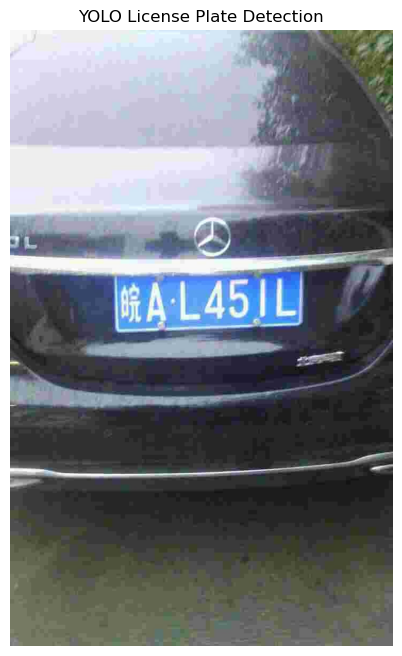

In [19]:
# Load one sucessfully detected image for chopping test

# Load YOLO model
model = YOLO("/Users/tim/Desktop/self-learning/Licence Plate Recognition/runs/detect/train_correct_labels/weights/best.pt")

test_images_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images"

# Check if YOLO detects any license plates
detected_image = None
for image_name in os.listdir(test_images_dir):
    image_path = os.path.join(test_images_dir, image_name)
    results = model(image_path)

    # Check if any bounding boxes are detected
    for r in results:
        if len(r.boxes) > 0:  # License plate detected
            detected_image = image_path
            break
    if detected_image:
        break

print("Find YOLO plate detected image:", detected_image)

# Display the detected image
if detected_image:  # Display the first detected image
    img = cv2.imread(detected_image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis("off")
    plt.title("YOLO License Plate Detection")
    plt.show()



image 1/1 /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images/0399461206897-90_90-188&444_561&576-559&560_204&573_201&456_556&443-0_0_10_28_29_25_10-166-54.jpg: 640x416 1 license_plate, 132.2ms
Speed: 1.4ms preprocess, 132.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)


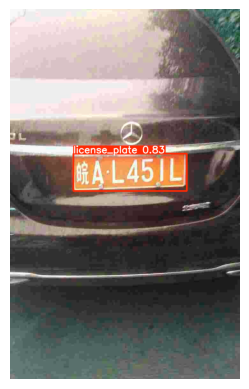

In [9]:
model = YOLO("/Users/tim/Desktop/self-learning/Licence Plate Recognition/runs/detect/train_correct_labels/weights/best.pt")  # Path to the trained YOLO model

results = model(detected_image)
# accuire the bounding box coordinates(numpy array, RGB image, and the original image shape)
annotated_img = results[0].plot()

# show in notebook
plt.imshow(annotated_img)
plt.axis("off")  # Turn off axis
plt.show() 

In [14]:
# chop the detected image to get the license plate


# Load the trained YOLO model
model = YOLO("/Users/tim/Desktop/self-learning/Licence Plate Recognition/runs/detect/train_correct_labels/weights/best.pt")  # Path to the trained YOLO model

# Define the test image path
test_image_path = detected_image


# Run YOLO detection with lower confidence
results = model(test_image_path, conf=0.06, imgsz=640)

# Read the test image
image = cv2.imread(test_image_path)
if image is None:
    print(" Failed to load image!")
    exit()
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Ensure the output directory exists
output_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/chop_image"
os.makedirs(output_dir, exist_ok=True)

# Process detected bounding boxes
for r in results:
    print("Bounding boxes (xyxy):", r.boxes.xyxy)  
    if len(r.boxes) == 0:
        print(" No bounding boxes detected!")
        continue

    print(" Detected bounding boxes:", r.boxes.xyxy)  # x_min, y_min, x_max, y_max

    for box in r.boxes.xyxy:
        x_min, y_min, x_max, y_max = map(int, box)
        print(f" Cropping plate: {x_min}, {y_min}, {x_max}, {y_max}")

        # Ensure bounding box is within image dimensions
        h, w, _ = image.shape
        x_min = max(0, x_min)
        y_min = max(0, y_min)
        x_max = min(w, x_max)
        y_max = min(h, y_max)

        # Crop the detected license plate
        cropped_plate = image[y_min:y_max, x_min:x_max]

        
        if cropped_plate is None or cropped_plate.size == 0:
            print(" Cropped plate is empty! Skipping this detection.")
            continue

        # Save cropped image
        save_path = os.path.join(output_dir, "cropped_plate.jpg")
        if cv2.imwrite(save_path, cropped_plate):
            print(f" Successfully saved cropped plate: {save_path}")
        else:
            print(" Failed to save cropped plate!")



image 1/1 /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images/0399461206897-90_90-188&444_561&576-559&560_204&573_201&456_556&443-0_0_10_28_29_25_10-166-54.jpg: 640x416 1 license_plate, 152.6ms
Speed: 6.0ms preprocess, 152.6ms inference, 10.5ms postprocess per image at shape (1, 3, 640, 416)
Bounding boxes (xyxy): tensor([[198.3911, 453.1135, 553.4400, 570.4417]])
 Detected bounding boxes: tensor([[198.3911, 453.1135, 553.4400, 570.4417]])
 Cropping plate: 198, 453, 553, 570
 Successfully saved cropped plate: /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/chop_image/cropped_plate.jpg


In [15]:
# check if the cropped image is saved successfully

# Load cropped plate
plate_image_path = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/chop_image/cropped_plate.jpg"

print(os.path.exists(plate_image_path))  


True


In [9]:
print(os.path.abspath(plate_image_path))  # Get the absolute path

/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/chop_image/cropped_plate.jpg


🔢 Detected License Plate Number: waar’


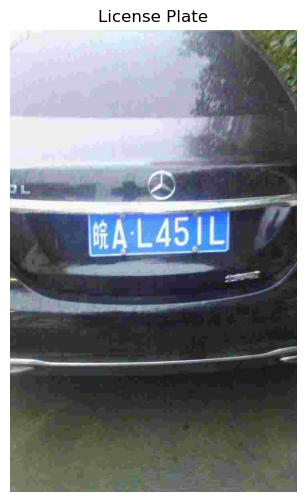

In [38]:

# Pytesseract OCR for license plate recognition

# Load the image
image = cv2.imread(test_image_path)
# Convert image from OpenCV BGR to Matplotlib RGB format
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


# Convert image to grayscale (improves OCR accuracy)
gray_plate = cv2.cvtColor(plate_image, cv2.COLOR_BGR2GRAY)

# Perform OCR
plate_text = pytesseract.image_to_string(gray_plate, config="--psm 7 -l chi_sim") 

print("🔢 Detected License Plate Number:", plate_text.strip())

# Display the image     
plt.figure(figsize=(8, 6))
plt.imshow(image_rgb)
plt.axis("off")
plt.title("License Plate")
plt.show()

[2025/02/21 18:10:14] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/Users/tim/.paddleocr/whl/det/ch/ch_PP-OCRv4_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/Users/tim/.paddleocr/whl/rec/ch/ch_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_length

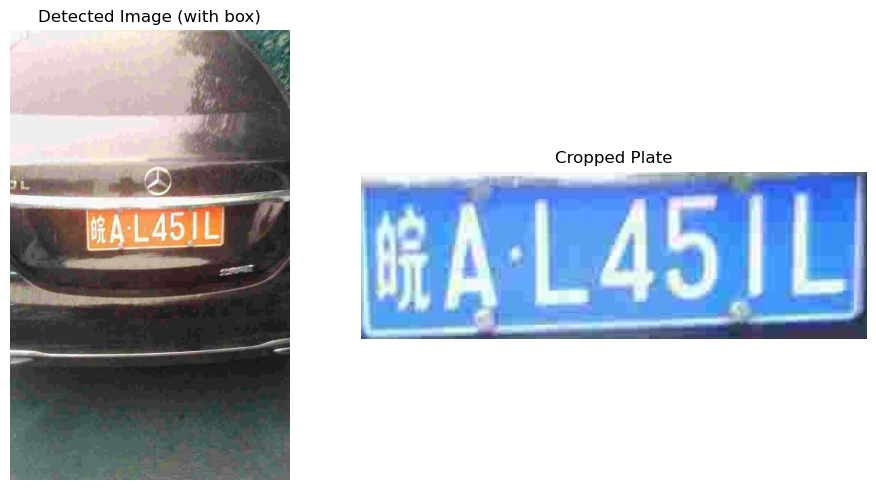

In [22]:
# PaddleOCR for lincense plate recognition(better than pytesseract)

# initialize the PaddleOCR model (CRNN model for text recognition)
ocr = PaddleOCR(use_angle_cls=True, lang="ch")  # "ch" for Chinese text recognition

# Define the cropped license plate image path
image_path = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/chop_image/cropped_plate.jpg"  

# Perform OCR on the license plate image
results = ocr.ocr(image_path, cls=True)

# Display the OCR results
for result in results:
    for line in result:
        text, confidence = line[1]
        print(f" Detected License Plate Number: {text} (Confidence: {confidence:.2f})")


fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 列 2 欄

# left: display the original image 
axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axes[0].set_title("Detected Image (with box)")
axes[0].axis("off")

# right: display the cropped license plate image
axes[1].imshow(cv2.cvtColor(plate_image, cv2.COLOR_BGR2RGB))
axes[1].set_title("Cropped Plate")
axes[1].axis("off")

plt.tight_layout()
plt.show()

In [17]:
# chop test images

# Load trained YOLO model
model = YOLO("/Users/tim/Desktop/self-learning/Licence Plate Recognition/runs/detect/train_correct_labels/weights/best.pt")  # 你的 YOLO 訓練權重

# Define directories
test_images_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images"  # 測試集圖片
cropped_plate_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/cropped_plates"  # 存放裁剪車牌
os.makedirs(cropped_plate_dir, exist_ok=True)

# Process each test image
for image_name in os.listdir(test_images_dir):
    if not image_name.endswith(".jpg"):
        continue  # Skip non-image files

    image_path = os.path.join(test_images_dir, image_name)
    image = cv2.imread(image_path)
    
    # Run YOLO detection
    results = model(image_path, conf=0.3, iou=0.5, imgsz=640)
    
    for r in results:
        for i, box in enumerate(r.boxes.xyxy):
            x_min, y_min, x_max, y_max = map(int, box)

            # Crop the detected plate
            cropped_plate = image[y_min:y_max, x_min:x_max]

            # Ensure the cropped plate is not empty
            if cropped_plate is None or cropped_plate.size == 0:
                print(f" Failed to crop plate for {image_name}")
                continue
            
            # Save cropped plate
            save_path = os.path.join(cropped_plate_dir, f"{image_name.replace('.jpg', '')}_plate_{i}.jpg")
            cv2.imwrite(save_path, cropped_plate)

print(" All license plates have been cropped and saved.")


image 1/1 /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images/0399461206897-90_90-188&444_561&576-559&560_204&573_201&456_556&443-0_0_10_28_29_25_10-166-54.jpg: 640x416 1 license_plate, 444.0ms
Speed: 19.0ms preprocess, 444.0ms inference, 12.1ms postprocess per image at shape (1, 3, 640, 416)

image 1/1 /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images/0166702586207-91_86-264&485_495&566-503&563_264&558_264&486_503&491-0_9_19_30_31_30_32-104-20.jpg: 640x416 1 license_plate, 205.6ms
Speed: 1.8ms preprocess, 205.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 416)

image 1/1 /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images/0158764367816-92_75-203&521_442&594-452&602_218&586_192&508_426&524-0_0_2_30_33_30_9-138-43.jpg: 640x416 1 license_plate, 221.3ms
Speed: 1.8ms preprocess, 221.3ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 416)

image 1/1 /Users/tim/Desktop/self

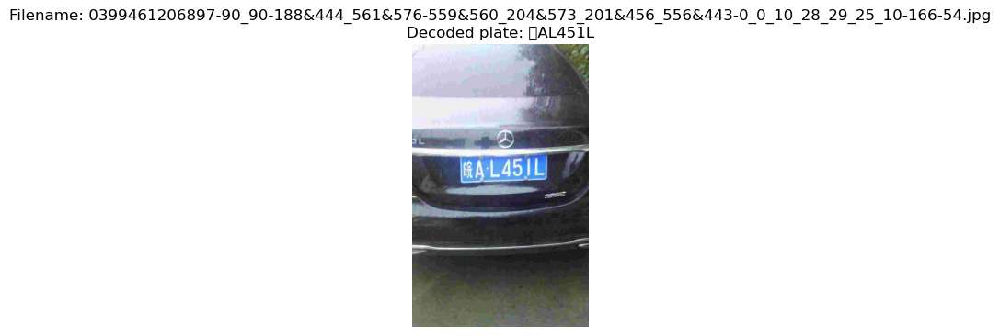

 Image name: 0399461206897-90_90-188&444_561&576-559&560_204&573_201&456_556&443-0_0_10_28_29_25_10-166-54.jpg | Decoded plate: 皖AL451L


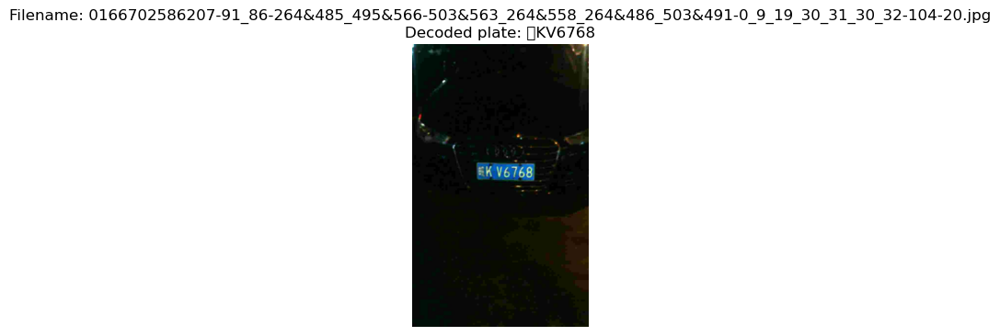

 Image name: 0166702586207-91_86-264&485_495&566-503&563_264&558_264&486_503&491-0_9_19_30_31_30_32-104-20.jpg | Decoded plate: 皖KV6768


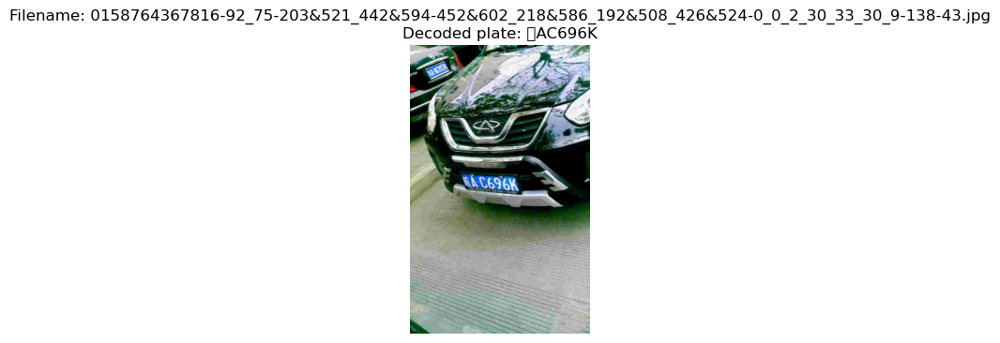

 Image name: 0158764367816-92_75-203&521_442&594-452&602_218&586_192&508_426&524-0_0_2_30_33_30_9-138-43.jpg | Decoded plate: 皖AC696K


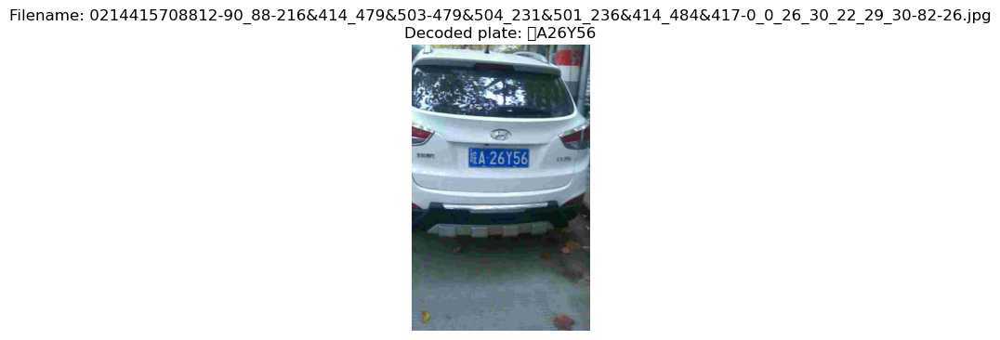

 Image name: 0214415708812-90_88-216&414_479&503-479&504_231&501_236&414_484&417-0_0_26_30_22_29_30-82-26.jpg | Decoded plate: 皖A26Y56


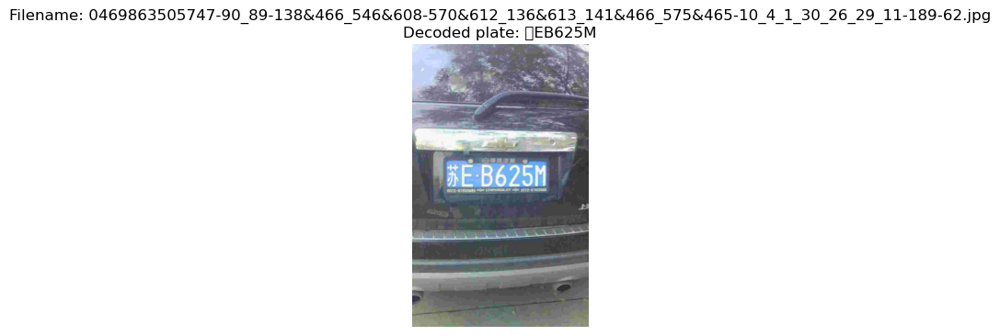

 Image name: 0469863505747-90_89-138&466_546&608-570&612_136&613_141&466_575&465-10_4_1_30_26_29_11-189-62.jpg | Decoded plate: 苏EB625M


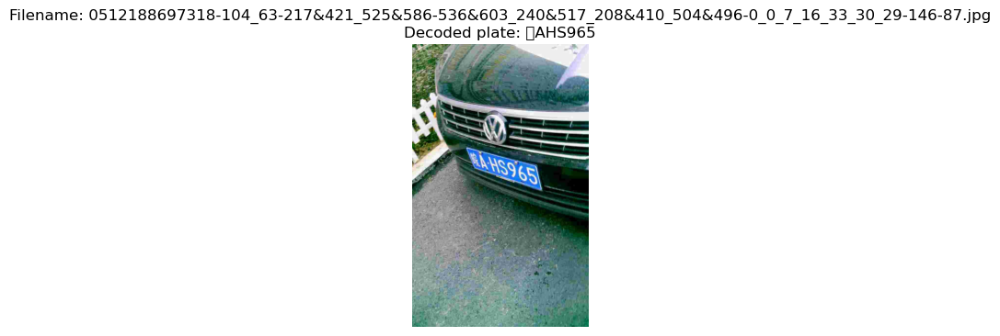

 Image name: 0512188697318-104_63-217&421_525&586-536&603_240&517_208&410_504&496-0_0_7_16_33_30_29-146-87.jpg | Decoded plate: 皖AHS965


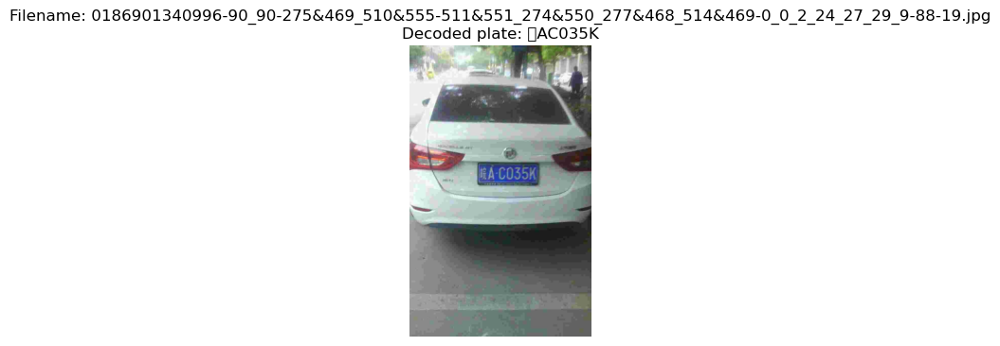

 Image name: 0186901340996-90_90-275&469_510&555-511&551_274&550_277&468_514&469-0_0_2_24_27_29_9-88-19.jpg | Decoded plate: 皖AC035K


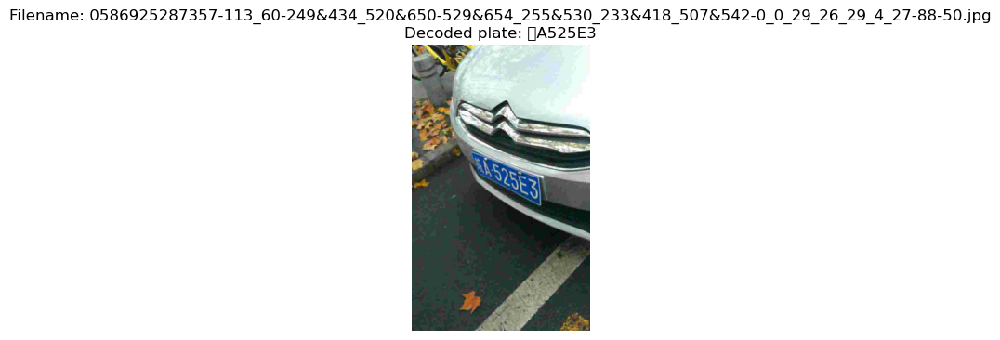

 Image name: 0586925287357-113_60-249&434_520&650-529&654_255&530_233&418_507&542-0_0_29_26_29_4_27-88-50.jpg | Decoded plate: 皖A525E3


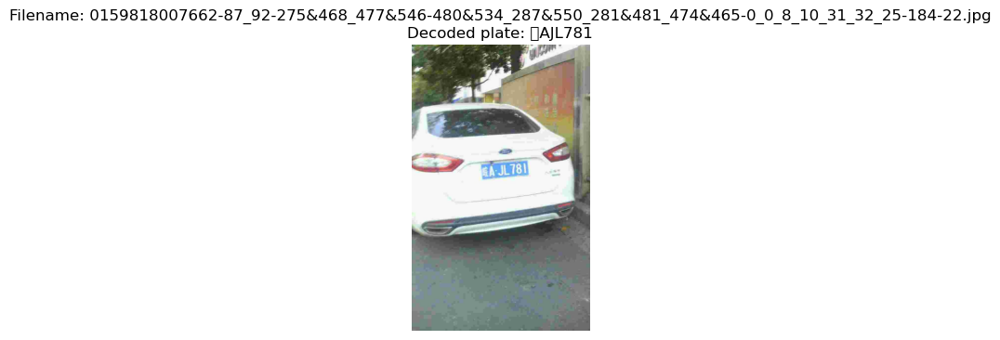

 Image name: 0159818007662-87_92-275&468_477&546-480&534_287&550_281&481_474&465-0_0_8_10_31_32_25-184-22.jpg | Decoded plate: 皖AJL781


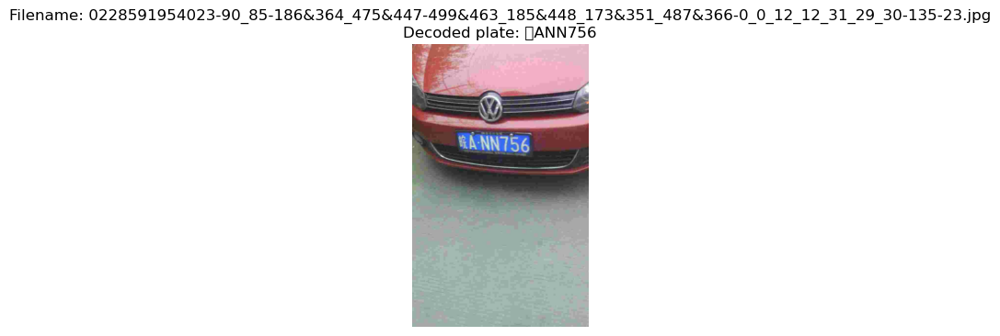

 Image name: 0228591954023-90_85-186&364_475&447-499&463_185&448_173&351_487&366-0_0_12_12_31_29_30-135-23.jpg | Decoded plate: 皖ANN756


In [10]:
# test the ground truth logic (license plate by decoding the plate number from the filename)

# provinces (31 in tatol)
provinces = [
    "皖","沪","津","渝","冀","晋","蒙","辽","吉","黑",
    "苏","浙","京","闽","赣","鲁","豫","鄂","湘","粤",
    "桂","琼","川","贵","云","藏","陕","甘","青","宁","新"
]

# alphadigit (34 in total) 0-9, A-Z except I, O
alphadigit = [
    
    'A','B','C','D','E','F','G','H','J','K',
    'L','M','N','P','Q','R','S','T','U','V',
    'W','X','Y','Z','0','1','2','3','4','5','6','7','8','9'
]

def decode_plate_from_filename(filename):

    # from filename, extract the plate indices, e.g., "0_0_25_3_25_24_27", and decode

    # remove file extension, e.g., ".jpg"
    base_name = os.path.splitext(filename)[0]
    # split by dash "-"
    parts = base_name.split('-')
    # the 5th part is the plate indices(index=4)
    plate_indices_str = parts[4]
    # convert to list 
    idxs = list(map(int, plate_indices_str.split('_')))  # [0, 0, 25, 3, 25, 24, 27] 之類
    # first two indices are province and letter, the rest are numbers and letters
    province_idx = idxs[0]  # province index(chinese character)
    letter_idx = idxs[1]   # letter index
    rest_idxs = idxs[2:]  # the rest of the indices(numbers and letters)

    # decode
    plate_str = provinces[province_idx] + alphadigit[letter_idx]
    for r in rest_idxs:
        plate_str += alphadigit[r]
    return plate_str


image_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/images"

# get the first 10 images
sample_images = os.listdir(image_dir)[:10]

for img_name in sample_images:
    # decode plate number from filename
    plate_text = decode_plate_from_filename(img_name)

    # read image
    img_path = os.path.join(image_dir, img_name)
    image_bgr = cv2.imread(img_path)
    if image_bgr is None:
        print(f"無法讀取圖片: {img_path}")
        continue

    # convert to RGB, as matplotlib expects
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    #  show image
    plt.figure(figsize=(6, 4))
    plt.imshow(image_rgb)
    plt.title(f"Filename: {img_name}\nDecoded plate: {plate_text}")
    plt.axis("off")
    plt.show()

    # print image name and decoded plate
    print(f" Image name: {img_name} | Decoded plate: {plate_text}")

In [38]:
# license plate recognition by decoding the plate number from the filename

# Define the CCPD dictionaries for decoding plate indices
provinces = [
    "皖","沪","津","渝","冀","晋","蒙","辽","吉","黑",
    "苏","浙","京","闽","赣","鲁","豫","鄂","湘","粤",
    "桂","琼","川","贵","云","藏","陕","甘","青","宁","新"
]

alphadigit = [
    
    'A','B','C','D','E','F','G','H','J','K',
    'L','M','N','P','Q','R','S','T','U','V',
    'W','X','Y','Z','0','1','2','3','4','5','6','7','8','9'
]

def decode_plate_from_filename(filename):
    """
    Decode the license plate string from a CCPD-style filename.
    If the filename contains '_plate_{i}', we remove that part
    to revert to the original CCPD naming scheme.
    
    Example:
      Original CCPD name: 'xxx-0_0_25_3_25_24_27-xx.jpg'
      Chopped name:       'xxx-0_0_25_3_25_24_27-xx_plate_0.jpg'
      We strip '_plate_0' -> 'xxx-0_0_25_3_25_24_27-xx'
      Then we extract the segment [4] -> '0_0_25_3_25_24_27' to decode.
    """
    # Remove file extension, e.g. '.jpg'
    base_name = os.path.splitext(filename)[0]
    
    # If the chopped image name contains '_plate_{i}', remove it to get back original CCPD format
    if "_plate_" in base_name:
        base_name = base_name.split("_plate_")[0]
    
    # Split by '-'
    parts = base_name.split('-')
    # Typically, parts[4] is something like '0_0_25_3_25_24_27'
    plate_indices_str = parts[4]
    
    # Convert to integer list
    idxs = list(map(int, plate_indices_str.split('_')))  # e.g. [0, 0, 25, 3, 25, 24, 27]
    
    # Decode: idxs[0] -> province, idxs[1] -> second char, idxs[2:] -> next 5 chars
    plate_str = provinces[idxs[0]] + alphadigit[idxs[1]]
    for r in idxs[2:]:
        plate_str += alphadigit[r]
    
    return plate_str

# Directories
label_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/labels"
cropped_plate_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/cropped_plates"

# Dictionary to store { cropped_image_name : plate_text }
ground_truth = {}

# Loop over label files
for label_file in os.listdir(label_dir):
    if not label_file.endswith(".txt"):
        continue  # Only process .txt label files
    
    # The "prefix" is the label file name minus ".txt"
    # Example: 'xxx-0_0_25_3_25_24_27-xx.txt' -> 'xxx-0_0_25_3_25_24_27-xx'
    prefix = label_file.replace(".txt", "")
    
    # Find all chopped images that start with the same prefix and end with .jpg
    matched_images = []
    for f in os.listdir(cropped_plate_dir):
        # If your chopped images are named like 'xxx-..._plate_0.jpg', 
        # they should start with 'xxx-...' 
        if f.startswith(prefix) and f.endswith(".jpg"):
            matched_images.append(f)
    
    if not matched_images:
        print(f" No chopped image found for prefix '{prefix}', skipping...")
        continue
    
    # Process each chopped image
    for image_name in matched_images:
        # Decode the plate text from the filename
        plate_number = decode_plate_from_filename(image_name)
        
        # Save to the ground_truth dictionary
        ground_truth[image_name] = plate_number
        print(f" Extracted plate: {plate_number} from {image_name}")

# Save the result to a JSON file
with open("/Users/tim/Desktop/self-learning/Licence Plate Recognition/ground_truth.json", "w", encoding="utf-8") as f:
    json.dump(ground_truth, f, indent=4, ensure_ascii=False)

print(" Ground Truth JSON successfully generated!")

 Extracted plate: 皖AYR773 from 0446551724138-87_92-257&439_563&567-575&543_270&576_279&463_584&430-0_0_22_15_31_31_27-116-119_plate_0.jpg
 Extracted plate: 皖AZ7711 from 0158704501916-90_85-208&465_465&545-482&548_211&546_206&469_477&471-0_0_23_31_31_25_25-164-45_plate_0.jpg
 Extracted plate: 皖A306B7 from 0207770593869-90_88-188&508_468&605-485&589_200&596_199&517_484&510-0_0_27_24_30_1_31-51-118_plate_0.jpg
 Extracted plate: 苏E89HS0 from 0122222222222-90_83-302&428_485&503-488&499_316&494_304&430_476&435-10_4_32_33_7_16_24-123-73_plate_0.jpg
 Extracted plate: 皖AKF795 from 00487068965517-91_83-355&475_478&529-475&529_354&524_352&481_473&486-0_0_9_5_31_33_29-107-12_plate_0.jpg
 Extracted plate: 皖AYJ176 from 023903256705-82_89-383&402_619&501-613&462_404&504_397&436_606&394-0_0_22_8_25_31_30-129-80_plate_0.jpg
 Extracted plate: 皖AQ2799 from 00754310344828-91_88-292&436_443&494-447&504_281&504_279&442_445&442-0_0_14_26_31_33_33-134-43_plate_0.jpg
 Extracted plate: 皖AK9R08 from 027066570881

In [40]:
import os
import json
import cv2
from paddleocr import PaddleOCR

def main():
    """
    Evaluates OCR results (PaddleOCR) against ground_truth.json,
    computing character-level and full-plate accuracy.
    """

    # 1) Initialize PaddleOCR
    # 'use_angle_cls=True' enables angle classification for text orientation;
    # 'lang="ch"' is for Chinese recognition.
    ocr = PaddleOCR(use_angle_cls=True, lang="ch")

    # 2) Define paths
    cropped_plate_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/cropped_plates"
    ground_truth_path = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/ground_truth.json"

    # 3) Load ground truth (dict: { "image_name": "true_plate_text", ... })
    with open(ground_truth_path, "r", encoding="utf-8") as f:
        ground_truths = json.load(f)

    # 4) Variables to store evaluation results
    total_chars = 0
    correct_chars = 0
    total_plates = len(ground_truths)
    correct_plates = 0

    # 5) Process each cropped plate image
    for image_name, true_text in ground_truths.items():
        image_path = os.path.join(cropped_plate_dir, image_name)

        # Read the cropped plate image
        plate_image = cv2.imread(image_path)
        if plate_image is None:
            print(f" Failed to load {image_name}")
            continue

        # Perform OCR with PaddleOCR
        # ocr.ocr(image, cls=True) returns a list of lists: [[ [coords], [text, confidence] ], ...]
        ocr_result = ocr.ocr(plate_image, cls=True)

        # Use nested loops to handle potential None values
        detected_text = ""
        if ocr_result:  # Check if not None or empty
            for res in ocr_result:
                if not res:
                    continue
                for line in res:
                    # Typically: line = [ [x1,y1,x2,y2...], [recognized_text, confidence] ]
                    if line and len(line) > 1 and line[1]:
                        text, conf = line[1]
                        detected_text += text

        detected_text = detected_text.strip()

        # Step A: Normalize both strings (remove separators like '·', spaces, etc.)
        true_text_clean = true_text.replace("·", "").replace(" ", "").replace(".", "").replace("-", "")
        detected_text_clean = detected_text.replace("·", "").replace(" ", "").replace(".", "").replace("-", "")

        # 6) Character-level accuracy
        total_chars += len(true_text_clean)
        min_len = min(len(true_text_clean), len(detected_text_clean))
        correct_chars += sum(1 for i in range(min_len) if true_text_clean[i] == detected_text_clean[i])

        # 7) Full-plate accuracy
        if true_text_clean == detected_text_clean:
            correct_plates += 1

        print(f"Ground Truth (raw): {true_text} | OCR (raw): {detected_text}")
        print(f"Ground Truth (clean): {true_text_clean} | OCR (clean): {detected_text_clean}\n")

    # 8) Calculate final accuracy scores
    char_accuracy = correct_chars / total_chars if total_chars else 0
    plate_accuracy = correct_plates / total_plates if total_plates else 0

    print("\nOCR Evaluation Results (with cleaning):")
    print(f"Character Accuracy: {char_accuracy:.2%}")
    print(f"Full Plate Accuracy: {plate_accuracy:.2%}")

if __name__ == "__main__":
    main()

[2025/02/21 14:10:48] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/Users/tim/.paddleocr/whl/det/ch/ch_PP-OCRv4_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/Users/tim/.paddleocr/whl/rec/ch/ch_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_length

[2025/02/21 19:29:13] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/Users/tim/.paddleocr/whl/det/ch/ch_PP-OCRv4_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/Users/tim/.paddleocr/whl/rec/ch/ch_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_length

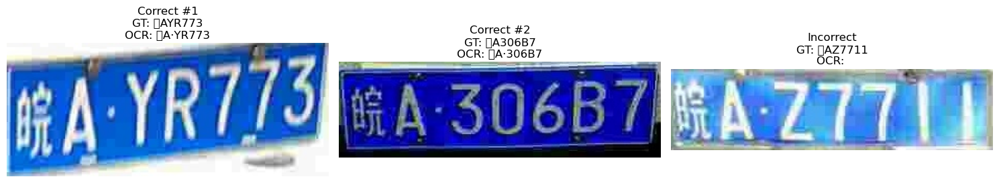

In [35]:
import os
import json
import cv2
import matplotlib.pyplot as plt
from paddleocr import PaddleOCR

def main():
    """
    Reads cropped plate images, performs PaddleOCR,
    and displays two correctly recognized images plus one incorrectly recognized image.
    Then exits without calculating accuracy.
    """

    # 1) Initialize PaddleOCR
    ocr = PaddleOCR(use_angle_cls=True, lang="ch")

    # 2) Define paths
    cropped_plate_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/cropped_plates"
    ground_truth_path = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/ground_truth.json"

    # 3) Load ground truth
    with open(ground_truth_path, "r", encoding="utf-8") as f:
        ground_truths = json.load(f)

    # Lists to store examples for display
    correct_examples = []
    incorrect_examples = []

    # 4) Process each cropped plate image
    for image_name, true_text in ground_truths.items():
        image_path = os.path.join(cropped_plate_dir, image_name)

        # Read the cropped plate image
        plate_image = cv2.imread(image_path)
        if plate_image is None:
            print(f"Failed to load {image_name}")
            continue

        # Perform OCR with PaddleOCR
        ocr_result = ocr.ocr(plate_image, cls=True)

        # Gather detected text
        detected_text = ""
        if ocr_result:
            for res in ocr_result:
                if not res:
                    continue
                for line in res:
                    if line and len(line) > 1 and line[1]:
                        text, conf = line[1]
                        detected_text += text

        detected_text = detected_text.strip()

        # Normalize strings (remove '·', spaces, etc.)
        true_text_clean = true_text.replace("·", "").replace(" ", "").replace(".", "").replace("-", "")
        detected_text_clean = detected_text.replace("·", "").replace(" ", "").replace(".", "").replace("-", "")

        # Check correctness
        if true_text_clean == detected_text_clean:
            correct_examples.append((plate_image, true_text, detected_text))
        else:
            incorrect_examples.append((plate_image, true_text, detected_text))

        # Once we have at least 2 correct and 1 incorrect, we can stop
        if len(correct_examples) >= 2 and len(incorrect_examples) >= 1:
            break

    # If we didn't find enough examples, just exit
    if len(correct_examples) < 2 or len(incorrect_examples) < 1:
        print("Not enough correct/incorrect examples found.")
        return

    # Display the two correct images and one incorrect image
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # First correct example
    img1, gt1, ocr1 = correct_examples[0]
    axes[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    axes[0].set_title(f"Correct #1\nGT: {gt1}\nOCR: {ocr1}")
    axes[0].axis("off")

    # Second correct example
    img2, gt2, ocr2 = correct_examples[1]
    axes[1].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
    axes[1].set_title(f"Correct #2\nGT: {gt2}\nOCR: {ocr2}")
    axes[1].axis("off")

    # One incorrect example
    img3, gt3, ocr3 = incorrect_examples[0]
    axes[2].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
    axes[2].set_title(f"Incorrect\nGT: {gt3}\nOCR: {ocr3}")
    axes[2].axis("off")

    plt.tight_layout()
    plt.show()

    # End immediately without computing any accuracy

if __name__ == "__main__":
    main()

In [34]:
# evaluate the OCR results with EasyOCR

def main():
    """
    Evaluates OCR results (EasyOCR) against ground_truth.json,
    computing character-level and full-plate accuracy.
    """

    # 1) Define paths
    cropped_plate_dir = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/cropped_plates"
    ground_truth_path = "/Users/tim/Desktop/self-learning/Licence Plate Recognition/ground_truth.json"

    # 2) Load ground truth (dict: { "image_name": "true_plate_text", ... })
    with open(ground_truth_path, "r", encoding="utf-8") as f:
        ground_truths = json.load(f)

    # 3) Variables to store evaluation results
    total_chars = 0
    correct_chars = 0
    total_plates = len(ground_truths)
    correct_plates = 0

    # 4) Initialize EasyOCR Reader
    # 'ch_sim' is for Simplified Chinese. 
    reader = easyocr.Reader(['ch_sim'], gpu=True)

    # 5) Process each cropped plate image
    for image_name, true_text in ground_truths.items():
        image_path = os.path.join(cropped_plate_dir, image_name)

        # Read the cropped plate image
        plate_image = cv2.imread(image_path)
        if plate_image is None:
            print(f" Failed to load {image_name}")
            continue

        # Convert to grayscale for possibly better OCR accuracy
        gray_plate = cv2.cvtColor(plate_image, cv2.COLOR_BGR2GRAY)

        # 6) Perform OCR with EasyOCR
        # reader.readtext(...) returns a list of [ [x1,y1], [x2,y2], [x3,y3], [x4,y4], 'text', confidence ]
        # or in a simplified form [coords, text, confidence].
        results = reader.readtext(gray_plate, detail=1)

        detected_text = ""
        for item in results:
            # Each item is typically: [bbox_coords, text, confidence]
            text = item[1]
            detected_text += text

        detected_text = detected_text.strip()

        # Step A: Normalize both strings (remove separators like '·', spaces, '.', '-')
        true_text_clean = true_text.replace("·", "").replace(" ", "").replace(".", "").replace("-", "")
        detected_text_clean = detected_text.replace("·", "").replace(" ", "").replace(".", "").replace("-", "")

        # 7) Character-level accuracy
        total_chars += len(true_text_clean)
        min_len = min(len(true_text_clean), len(detected_text_clean))
        correct_chars += sum(1 for i in range(min_len) if true_text_clean[i] == detected_text_clean[i])

        # 8) Full-plate accuracy
        if true_text_clean == detected_text_clean:
            correct_plates += 1

        # Print intermediate results for inspection
        print(f"Ground Truth (raw): {true_text} | OCR (raw): {detected_text}")
        print(f"Ground Truth (clean): {true_text_clean} | OCR (clean): {detected_text_clean}\n")

    # 9) Calculate final accuracy scores
    char_accuracy = correct_chars / total_chars if total_chars else 0
    plate_accuracy = correct_plates / total_plates if total_plates else 0

    print("\nOCR Evaluation Results (EasyOCR, with cleaning):")
    print(f"Character Accuracy: {char_accuracy:.2%}")
    print(f"Full Plate Accuracy: {plate_accuracy:.2%}")

if __name__ == "__main__":
    main()

[2025-02-21 19:12:11,482] [ WARNING] easyocr.py:251 - Downloading detection model, please wait. This may take several minutes depending upon your network connection.


Progress: |██████████████████████████████████████████████████| 100.0% Complete

[2025-02-21 19:12:14,524] [ WARNING] easyocr.py:176 - Downloading recognition model, please wait. This may take several minutes depending upon your network connection.


Progress: |██████████████████████████████████████████████████| 100.0% CompleteGround Truth (raw): 皖AYR773 | OCR (raw): 院4'丫87731
Ground Truth (clean): 皖AYR773 | OCR (clean): 院4'丫87731

Ground Truth (raw): 皖AZ7711 | OCR (raw): 皖42771
Ground Truth (clean): 皖AZ7711 | OCR (clean): 皖42771

Ground Truth (raw): 皖A306B7 | OCR (raw): [4.30687
Ground Truth (clean): 皖A306B7 | OCR (clean): [430687

Ground Truth (raw): 苏E89HS0 | OCR (raw): 匦 8950
Ground Truth (clean): 苏E89HS0 | OCR (clean): 匦8950

Ground Truth (raw): 皖AKF795 | OCR (raw): 袄巡799
Ground Truth (clean): 皖AKF795 | OCR (clean): 袄巡799

Ground Truth (raw): 皖AYJ176 | OCR (raw): 厩(]1 70
Ground Truth (clean): 皖AYJ176 | OCR (clean): 厩(]170

Ground Truth (raw): 皖AQ2799 | OCR (raw): [02799
Ground Truth (clean): 皖AQ2799 | OCR (clean): [02799

Ground Truth (raw): 皖AK9R08 | OCR (raw): 旒4 《908
Ground Truth (clean): 皖AK9R08 | OCR (clean): 旒4《908

Ground Truth (raw): 浙BX501B | OCR (raw): 郦*50旧
Ground Truth (clean): 浙BX501B | OCR (clean): 郦*50旧

Ground 

In [32]:
# YOLO evaluation on the test dataset
model = YOLO("/Users/tim/Desktop/self-learning/Licence Plate Recognition/runs/detect/train_correct_labels/weights/best.pt")
metrics = model.val(data="/Users/tim/Desktop/self-learning/Licence Plate Recognition/runs/detect/train_correct_labels/yolo_config.yaml", split="test")
#  mAP、Precision、Recall
print(metrics.box.map, metrics.box.map50, metrics.box.mp, metrics.box.mr)

Ultralytics 8.3.76 🚀 Python-3.9.16 torch-2.1.0.dev20230724 CPU (Apple M2 Pro)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/labels... 20000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 20000/20000 [00:03<00:00, 5166.48it/s]


val: New cache created: /Users/tim/Desktop/self-learning/Licence Plate Recognition/CCPD_YOLO/test/labels.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1250/1250 [1:58:59<00:00,  5.71s/it] 


                   all      20000      20000          1          1      0.995      0.786
Speed: 0.2ms preprocess, 352.4ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to runs/detect/val6
0.7857401909120958 0.99497371132499 0.9998197237299753 1.0
